<a href="https://colab.research.google.com/github/nuvita97/music-source-separation/blob/dl-model/pre-trained.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MUSIC SOURCE SEPARATION (MSS)

---

**Goal**: to separate instruments from an original song by vocals, drums, bass, and other.

**Dataset**: We use [MUSDB18](https://sigsep.github.io/datasets/musdb.html) dataset, which is a famous sourch used for MSS research. It contains a total of 100 pop music tracks, each with 4 stems: vocals, drums, bass, and other instrument.

**Evaluation Metrics**: SDR (Signal-to-Distortion Ratio) - an objective metric that measures the amount of distortion in the separated sources. It is calculated by comparing the magnitude spectrogram of the separated source to the magnitude spectrogram of the target source. *A higher SDR score indicates that the separated source is more similar to the target source*.

> **Approach**: Here because training the model oulselves cost too much resources including memory, GPU, and might take days of training, we choose to use pre-trained models to make inference for preprocessed data, and evaluate them. The 2 chosen models:
> - Hybrid-Demucs
> - Open-Unmix

In [ ]:
!pip install mir_eval
!pip install musdb
!pip install museval
!pip install openunmix

In [3]:
import torch
import torchaudio
import matplotlib.pyplot as plt
import pandas as pd

import musdb
from mir_eval import separation
from IPython.display import Audio
from torchaudio.pipelines import HDEMUCS_HIGH_MUSDB_PLUS
from torchaudio.utils import download_asset
from torchaudio.transforms import Fade

import warnings
warnings.filterwarnings('ignore')

# HYBRID-DEMUCS

*Source: [Hybrid Transformers for Music Source Separation](https://https://arxiv.org/pdf/2211.08553v1.pdf) - Simon Rouard, Francisco Massa, Alexandre Defossez*

Hybrid Demucs (HT Demucs) is a transformer-based architecture designed by Facebook Research for MSS that combines the strengths of local and long-range contextual information. HT Demucs consists of two U-Nets: a temporal U-Net and a spectral U-Net. The temporal U-Net uses temporal convolutions to extract local acoustic features, while the spectral U-Net uses spectrogram-domain convolutions to extract spectral features. The innermost layers of both U-Nets are replaced by a cross-domain Transformer Encoder, which uses self-attention within one domain and cross-attention across domains. This allows HT Demucs to integrate both local and long-range information to improve source separation performance. HT Demucs has been shown to outperform previous state-of-the-art methods on the MUSDB18 dataset, achieving a Signal-to-Distortion Ratio (SDR) of 9.20 dB.

<img src="https://github.com/nuvita97/music-source-separation/blob/dl-model/images/hybrid-demucs.png?raw=1" alt="Hybrid-Demucs" style="width: 800px;"/>


## Processing

In [5]:
# Setup model and sample rate

bundle = HDEMUCS_HIGH_MUSDB_PLUS
model = bundle.get_model()
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)
sample_rate = bundle.sample_rate

print(f"Sample rate: {sample_rate}")

100%|██████████| 319M/319M [00:03<00:00, 94.2MB/s]


Sample rate: 44100


In [6]:
# Processing audio signals in segments
def separate_sources(
  model,
  mix,
  segment=10.0,
  overlap=0.1,
  device=None,
):
  if device is None:
    device = mix.device
  else:
    device = torch.device(device)

  batch, channels, length = mix.shape

  chunk_len = int(sample_rate * segment * (1 + overlap))
  start = 0
  end = chunk_len
  overlap_frames = overlap * sample_rate
  fade = Fade(fade_in_len=0, fade_out_len=int(overlap_frames), fade_shape="linear")

  final = torch.zeros(batch, len(model.sources), channels, length, device=device)

  while start < length - overlap_frames:
    chunk = mix[:, :, start:end]
    with torch.no_grad():
      out = model.forward(chunk)
    out = fade(out)
    final[:, :, :, start:end] += out
    if start == 0:
      fade.fade_in_len = int(overlap_frames)
      start += int(chunk_len - overlap_frames)
    else:
      start += chunk_len
    end += chunk_len
    if end >= length:
      fade.fade_out_len = 0
  return final

In [7]:
# Separate a song into sources by model
def separate_song(song, model=model):
  waveform, sample_rate = torchaudio.load(song.path)
  mixture = waveform

  # parameters
  segment: int = 10
  overlap = 0.1
  # print("Separating track")
  ref = waveform.mean(0)
  # normalization
  waveform = (waveform - ref.mean()) / ref.std()

  sources = separate_sources(
    model,
    waveform[None],
    device=device,
    segment=segment,
    overlap=overlap,
  )[0]
  sources = sources * ref.std() + ref.mean()

  sources_list = model.sources
  sources = list(sources)

  audios = dict(zip(sources_list, sources))
  return {'audios': audios,
          'mixture': mixture,
          'rate': sample_rate}

In [10]:
# Setup computing the Short-Time Fourier Transform (STFT) of an audio signal
N_FFT = 4096
N_HOP = 4
stft = torchaudio.transforms.Spectrogram(
  n_fft=N_FFT,
  hop_length=N_HOP,
  power=None,
)

In [11]:
# Splot spectrogram of a STFT
def plot_spectrogram(stft, title="Spectrogram"):
  magnitude = stft.abs()
  spectrogram = 20 * torch.log10(magnitude + 1e-8).numpy()
  _, axis = plt.subplots(1, 1)
  axis.imshow(spectrogram, cmap="viridis", vmin=-60, vmax=0, origin="lower", aspect="auto")
  axis.set_title(title)
  plt.tight_layout()


# Calculate SDR score between original audio and predicted audio
def sdr_score(original_source, predicted_source):
  score = separation.bss_eval_sources(original_source.detach().numpy(), predicted_source.detach().numpy())[0].mean()
  return score


# Show outputs including: SDR score, Spectrogram, and Audio
def output_results(original_source: torch.Tensor, predicted_source: torch.Tensor, source: str, sample_rate):
  score = sdr_score(original_source, predicted_source)
  print("SDR score is: ", score)
  plot_spectrogram(stft(predicted_source)[0], f"Spectrogram - {source}")
  return Audio(predicted_source, rate=sample_rate)

In [12]:
# Return original and predicted source for each instrument
def get_results(audios, mixture, sample_rate):
  segment_start = 0
  segment_end = 10

  frame_start = segment_start * sample_rate
  frame_end = segment_end * sample_rate

  drums_spec = audios["drums"][:, frame_start:frame_end].cpu()
  drums = torch.from_numpy(track.targets['drums'].audio).T
  # print(drums.shape, drums_spec.shape, sample_rate)

  bass_spec = audios["bass"][:, frame_start:frame_end].cpu()
  bass = torch.from_numpy(track.targets['bass'].audio).T
  # print(bass.shape, bass_spec.shape, sample_rate)

  vocals_spec = audios["vocals"][:, frame_start:frame_end].cpu()
  vocals = torch.from_numpy(track.targets['vocals'].audio).T
  # print(vocals.shape, vocals_spec.shape, sample_rate)

  other_spec = audios["other"][:, frame_start:frame_end].cpu()
  other = torch.from_numpy(track.targets['other'].audio).T
  # print(other.shape, other_spec.shape, sample_rate)

  return {'drums': [drums, drums_spec],
          'bass': [bass, bass_spec],
          'vocals': [vocals, vocals_spec],
          'other': [other, other_spec]}

In [19]:
# Initialzie MUSDB dataset with Stems format
mus = musdb.DB(download=True, is_wav=False)

100%|██████████| 140M/140M [00:00<00:00, 191MB/s]


In [26]:
# Make inference by getting a track in MUSDB
track = mus[42]
print(track.name)
Audio(track.audio.T, rate=track.rate)

James May - On The Line


In [27]:
# Get Vocals stem from the track
vocals = track.targets['vocals']
print(vocals)
Audio(vocals.audio.T, rate=track.rate)

vocals


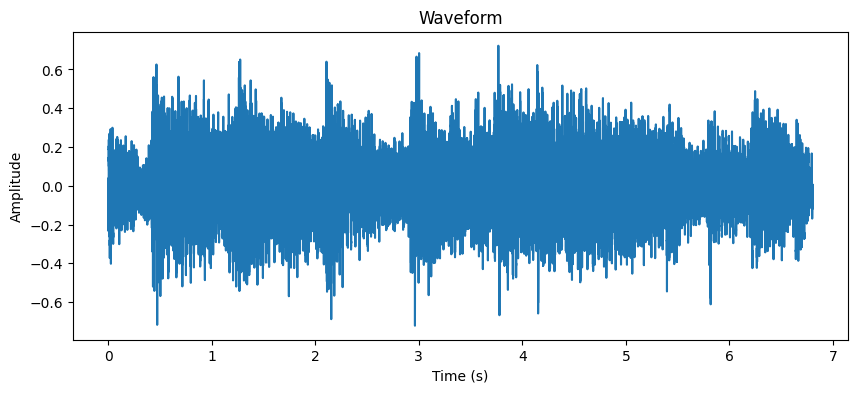

In [32]:
# Get waveform of audio
waveform, sample_rate = torchaudio.load(track.path)

# Calculate time axis in seconds
time_axis = torch.arange(0, waveform.size(1)) / sample_rate

# Plot the waveform against time
plt.figure(figsize=(10, 4))
plt.plot(time_axis.numpy(), waveform[0].numpy())
plt.title('Waveform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()

In [36]:
# Preprocess and separate stems
print(track)
separated = separate_song(track)
results = get_results(separated['audios'], separated['mixture'], separated['rate'])
results.keys()

James May - On The Line


dict_keys(['drums', 'bass', 'vocals', 'other'])

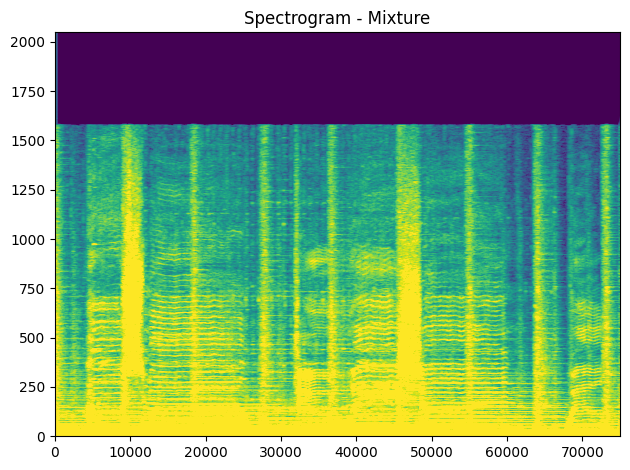

In [30]:
# Mixture Clip
plot_spectrogram(stft(separated['mixture'])[0], "Spectrogram - Mixture")
Audio(separated['mixture'], rate=separated['rate'])

SDR score is:  9.725446503063486


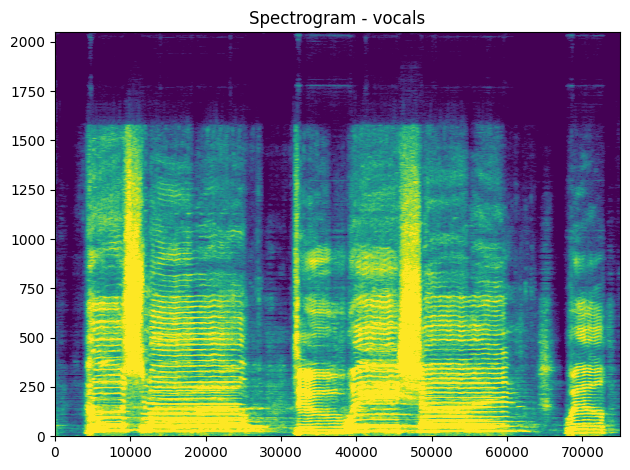

In [40]:
# Vocals output
output_results(results['vocals'][0], results['vocals'][1], "vocals", separated['rate'])

SDR score is:  10.481270305588556


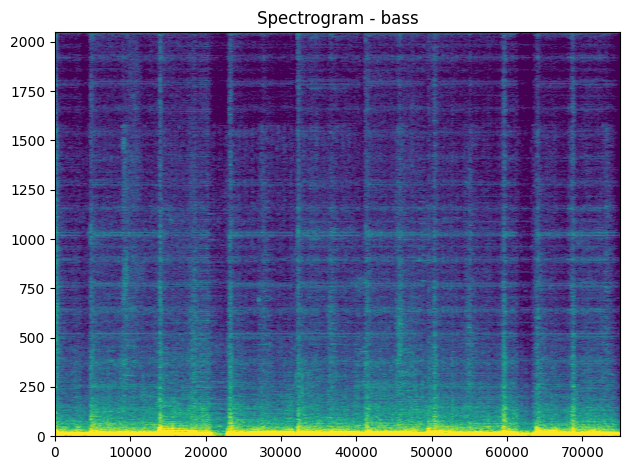

In [39]:
# Bass output
output_results(results['bass'][0], results['bass'][1], "bass", separated['rate'])

SDR score is:  10.05065534891785


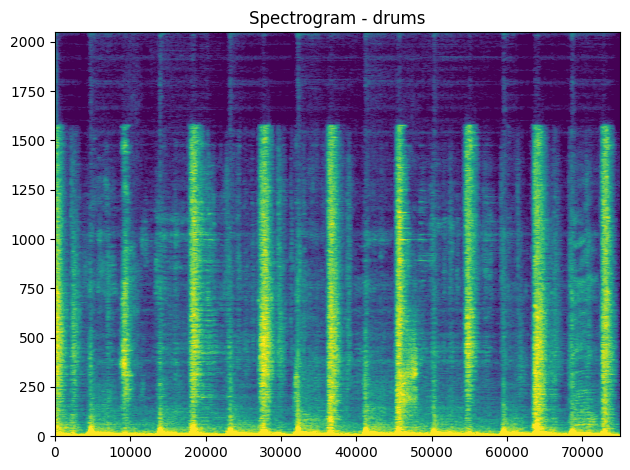

In [38]:
# Drums output
output_results(results['drums'][0], results['drums'][1], "drums", separated['rate'])

SDR score is:  6.496032274521415


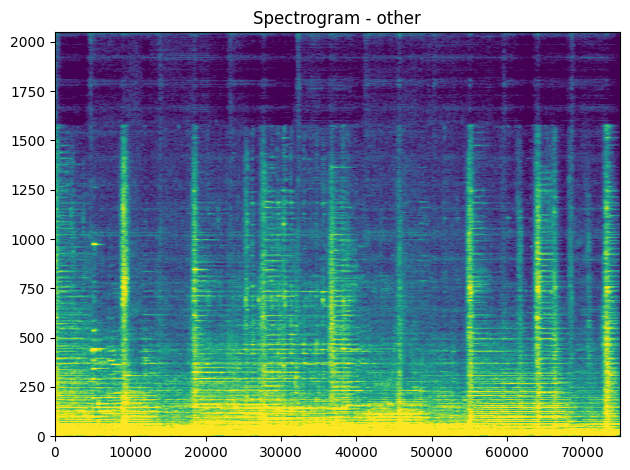

In [41]:
# Other output
output_results(results['other'][0], results['other'][1], "other", separated['rate'])

## Evaluation

After making inference and evaluate SDR score for one track, we will evaluate all scores for every track and save into a dataframe table

In [42]:
df_demucs = pd.DataFrame(columns=['song', 'vocals', 'bass', 'drums', 'other'])
test_songs = mus[-50:]

for track in test_songs:
  print(track)

  separated = separate_song(track)
  results = get_results(separated['audios'], separated['mixture'], separated['rate'])

  row = {}
  row['song']= track.name
  for component in results:
    comp_sdr = sdr_score(results[component][0], results[component][1])
    row[component] = comp_sdr

  # Save scores of each song in to table
  df_demucs = df_demucs.append(row, ignore_index=True)

df_demucs

AM Contra - Heart Peripheral
Al James - Schoolboy Facination
Angels In Amplifiers - I'm Alright
Arise - Run Run Run
BKS - Bulldozer
BKS - Too Much
Ben Carrigan - We'll Talk About It All Tonight
Bobby Nobody - Stitch Up
Buitraker - Revo X
Carlos Gonzalez - A Place For Us
Cristina Vane - So Easy
Detsky Sad - Walkie Talkie
Enda Reilly - Cur An Long Ag Seol
Forkupines - Semantics
Georgia Wonder - Siren
Girls Under Glass - We Feel Alright
Hollow Ground - Ill Fate
James Elder & Mark M Thompson - The English Actor
Juliet's Rescue - Heartbeats
Little Chicago's Finest - My Own
Louis Cressy Band - Good Time
Lyndsey Ollard - Catching Up
M.E.R.C. Music - Knockout
Moosmusic - Big Dummy Shake
Motor Tapes - Shore
Mu - Too Bright
Nerve 9 - Pray For The Rain
PR - Happy Daze
PR - Oh No
Punkdisco - Oral Hygiene
Raft Monk - Tiring
Sambasevam Shanmugam - Kaathaadi
Secretariat - Borderline
Secretariat - Over The Top
Side Effects Project - Sing With Me
Signe Jakobsen - What Have You Done To Me
Skelpolu - Res

,song,vocals,bass,drums,other
0,AM Contra - Heart Peripheral,11.556328,4.037353,7.899153,0.515543
1,Al James - Schoolboy Facination,8.997625,15.239475,5.942231,4.968284
2,Angels In Amplifiers - I'm Alright,11.704066,7.454158,7.718245,7.135544
3,Arise - Run Run Run,8.482244,13.651761,12.921641,12.416357
4,BKS - Bulldozer,6.696821,7.973741,10.061026,3.721813
5,BKS - Too Much,10.864976,12.923395,10.010377,5.986973
6,Ben Carrigan - We'll Talk About It All Tonight,5.282275,14.585636,9.039562,3.917764
7,Bobby Nobody - Stitch Up,8.507368,6.206606,5.793058,5.768023
8,Buitraker - Revo X,4.765570,10.908787,15.426500,7.198513
9,Carlos Gonzalez - A Place For Us,7.281050,-19.087390,5.832062,3.820028


from matplotlib import pyplot as plt
df_demucs['vocals'].plot(kind='hist', bins=20, title='vocals')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df_demucs['bass'].plot(kind='hist', bins=20, title='bass')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df_demucs['drums'].plot(kind='hist', bins=20, title='drums')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df_demucs['other'].plot(kind='hist', bins=20, title='other')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df_demucs.plot(kind='scatter', x='vocals', y='bass', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df_demucs.plot(kind='scatter', x='bass', y='drums', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df_demucs.plot(kind='scatter', x='drums', y='other', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df_demucs['vocals'].plot(kind='line', figsize=(8, 4), title='vocals')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
df_demucs['bass'].plot(kind='line', figsize=(8, 4), title='bass')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
df_demucs['drums'].plot(kind='line', figsize=(8, 4), title='drums')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
df_demucs['other'].plot(kind='line', figsize=(8, 4), title='other')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_0['index'].plot(kind='hist', bins=20, title='index')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_1['vocals'].plot(kind='hist', bins=20, title='vocals')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_2['bass'].plot(kind='hist', bins=20, title='bass')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_3['drums'].plot(kind='hist', bins=20, title='drums')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_4.plot(kind='scatter', x='index', y='vocals', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_5.plot(kind='scatter', x='vocals', y='bass', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_6.plot(kind='scatter', x='bass', y='drums', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_7.plot(kind='scatter', x='drums', y='other', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  from matplotlib import pyplot as plt
  import seaborn as sns
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['vocals']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_8.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('vocals')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  from matplotlib import pyplot as plt
  import seaborn as sns
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['bass']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_9.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('bass')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  from matplotlib import pyplot as plt
  import seaborn as sns
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['drums']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_10.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('drums')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  from matplotlib import pyplot as plt
  import seaborn as sns
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['other']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_11.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('other')

from matplotlib import pyplot as plt
_df_12['index'].plot(kind='line', figsize=(8, 4), title='index')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_13['vocals'].plot(kind='line', figsize=(8, 4), title='vocals')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_14['bass'].plot(kind='line', figsize=(8, 4), title='bass')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_15['drums'].plot(kind='line', figsize=(8, 4), title='drums')
plt.gca().spines[['top', 'right']].set_visible(False)

# OPEN-UNMIX

*Source: [Open-Unmix - A Reference Implementation for Music Source Separation](https://https://www.theoj.org/joss-papers/joss.01667/10.21105.joss.01667.pdf) - Fabian-Robert Stöter, Stefan Uhlich, Antoine Liutkus, and Yuki Mitsufuji*

Open Unmix is a deep neural network reference implementation for music source separation (MSS). It is based on a three-layer bidirectional deep LSTM (BiD-LSTM) network. The BiD-LSTM learns to predict the magnitude spectrogram of a target source, such as vocals, from the magnitude spectrogram of a mixture input. The actual separation is done in a post-processing step involving a multichannel Wiener filter.

<img src="https://github.com/nuvita97/music-source-separation/blob/dl-model/images/open-unmix.png?raw=1" alt="Open-Unmix" style="width: 800px;"/>

## Processing

In [ ]:
track = mus[42]
print(track.name)
display(Audio(track.audio.T, rate=track.rate))

James May - On The Line


In [ ]:
from openunmix import predict

estimates = predict.separate(
    torch.as_tensor(track.audio).float(),
    rate=track.rate,
    device=device
)
for target, estimate in estimates.items():
    print(target)
    audio = estimate.detach().cpu().numpy()[0]
    display(Audio(audio, rate=track.rate))

vocals


drums


bass


other


In [ ]:
estimates['vocals'].shape

torch.Size([1, 2, 300032])

In [ ]:
vocals_est = estimates['vocals'].squeeze(0)
vocals_org = torch.from_numpy(track.targets['vocals'].audio).T

sdr_score(vocals_org, vocals_est)

9.32649493240004

In [ ]:
vocals.shape

torch.Size([2, 300032])

In [ ]:
sdr_score(vocals, output_tensor)

8.799889031339799

SDR score is:  8.799889031339799


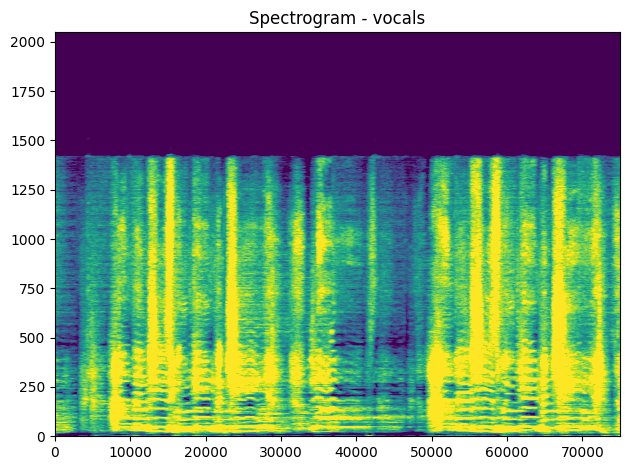

In [ ]:
output_results(vocals, output_tensor, "vocals", track.rate)

## Evaluation

In [ ]:
import stempeg

estimates_numpy = {}

for target, estimate in estimates.items():
    estimates_numpy[target] = torch.squeeze(estimate).detach().cpu().numpy().T

In [ ]:
track_scores = museval.eval_mus_track(track, estimates)
print(track_scores)

(300032, 2)

In [ ]:
df_umix =

# CONCLUSION